# Accelerating Physically Based Rendering by CNN

### Team Members: Chang Xiao (cx2180), Ye Zhang (yz3060)

This work is collaborate with Chang Xiao. Here is the specific detail of our individual contribution.

Network Design (Chang, Ye)

Data preparation (Chang)

Training (Chang)

Results Evaluation (Ye)

## Introduction to Physically Based Rendering

Physically based rendering has been studied for a long time in computer graphics community. To obtain a photo realistic image, one require solving the [rendering equation](https://en.wikipedia.org/wiki/Rendering_equation) [1]:

$$ L_o(x, \omega_o, \lambda, t) = L_e(x, \omega_o, \lambda, t) + \int f_r(x, \omega_i, \omega_o, \lambda, t) L_i(x, \omega_i, \lambda, t) (\omega_i \cdot n) \,\mathrm {d} \omega_i $$

<img src="report_files/1.png" style="width: 250px;">

This prblem can be solved by Monte Carlo integration. Monte Carlo (MC) rendering systems approximate this integral by tracing light rays (samples) in the world space to evaluate the scene function. Although an approximation with just a few samples to this integral can be quickly evaluated, the inaccuracy of this estimate relative to the true value produces unacceptable noise in the resulting image. Since the variance of the MC estimator decreases linearly with the number
of samples, many samples are required to get a reliable estimate of the integral(see below). The high cost of computing additional rays results in lengthy render times that negatively affect the applicability of MC renderers in modern film production. To tackle this problem, we present a new deep learning based framework, that can produce an approximate image with large number of samples from a low sample input. To do this, we train a neural network on a set of noisy MC rendered images and their corresponding ground truth images, using a convolutional neural network tightly coupled with ResNet[2].



### Low Sample Image

It is rendered fast but the image is noisy.

<img src="report_files/low.png" style="width: 500px;">

### High Sample Image

The image is clean but it's very time-consuming to render such an image.

<img src="report_files/high.png" style="width: 500px;">

## Problem definition

Our task is to learn high sample images from low sample images, which can significantly reduce the time to get images with high quality. 

We use Convolutional Neural Network to solve this problem.

<img src="report_files/fx.png" style="width: 700px;">

## Data Preparation

The first thing we need to do for this project is preparing our training data. We use the most popular open source software for 3D modeling and rendering, called [Blender](https://www.blender.org/)[3]. By using blender, we construct over 100 different image pair for both high sample and low sample as our training data. Most of them have resolution larger than 1280x960.

## Network Design

We adopt VGG16 (without top layer) as our base model and add several Residual Network Blocks on the top of it. 

<img src="report_files/net.png" style="width: 700px;">

We generate training samples by randomly cut patches of size (224, 224) from low sample images and corresponding high sample images.

Since physically based rendered images share very similar feature with natural image, we adopt VGG16 as our base layers. The input of our network is RGB images patches with shape (224, 224, 3). The output of VGG16, which has shape(7, 7, 512) is then sent into several ResNet blocks with upsampling. The final output recovers the shape (224, 224, 3), which are the denoised image patches.

We define the final loss using the MSE loss between the network output image patches and ground truth image patches.

We made a lot of attempts before determining the final model.

At first, we tried Multi-Layer Perceptron, inspired by the article "Image denoising with multi-layer perceptrons"[6]. At the same time, we designed a simple fully convolutional network. By comparing the performance of MLP and FCN, we decided to put effort on CNN models. 

Then we designed a deep fully convolutional modal. Strangely the color of output is somewhat duller than ground true images. We found that it is because the size of patches is too small (28, 28). When we increased the size of patches, the color of ouput became aprroximate to ground true images.

To improve the performance, we adopted the pre-trained VGG16 as our base model, but excluding the top dense layers. We also change the size of patches to (224, 224), which is the default size of VGG16 input. And we made it further by adding several Residual Network blocks on the top of VGG16 to gain lower loss. Now we have our final model.

## Implementation Details

First we construct our network structure.

In [1]:
%matplotlib inline
import os,random
os.environ["KERAS_BACKEND"] = "tensorflow"
import numpy as np
import theano as th
import theano.tensor as T
from keras.utils import np_utils
import keras.models as models
from keras.layers import Input,merge
from keras.layers.core import Reshape,Dense,Dropout,Activation,Flatten
from keras.layers.advanced_activations import LeakyReLU
from keras.activations import *
from keras.layers.wrappers import TimeDistributed
from keras.layers.noise import GaussianNoise
from keras.layers.convolutional import Conv2D, Convolution2D, MaxPooling2D, ZeroPadding2D, Deconv2D, UpSampling2D
from keras.layers.recurrent import LSTM
from keras.callbacks import ModelCheckpoint
from keras.regularizers import *
from keras.layers.normalization import *
from keras.optimizers import *
from keras.datasets import mnist
import matplotlib.pyplot as plt
import cPickle, random, sys, keras
from keras.models import Model
from IPython import display

sys.path.append("../common")
from keras.utils import np_utils

#K.set_image_dim_ordering('th')

Using TensorFlow backend.


In [ ]:
def create_network():
    #fisrt we load the pre-trained vgg16 network
    from keras.applications.vgg16 import VGG16
    input_tensor = Input(shape=(224, 224, 3))
    base_model = VGG19(input_tensor=input_tensor,weights='imagenet', include_top=False)
    for layer in base_model.layers:
        layer.trainable = False
    x = base_model.output
    
    #the output of VGG connected to several resnet block, combined with upsampling.
    a = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = keras.layers.merge.Add()(a,x)
    x = UpSampling2D(size=(2,2))(x)
    a = x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = keras.layers.merge.Add()(a,x)
    x = UpSampling2D(size=(2,2))(x)
    a = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = keras.layers.merge.Add()(a,x)
    x = UpSampling2D(size=(2,2))(x)
    a = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = keras.layers.merge.Add()(a,x)
    x = UpSampling2D(size=(2,2))(x)
    a = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = keras.layers.merge.Add()(a,x)
    x = UpSampling2D(size=(2,2))(x)
    
    x = keras.layers.concatenate([x, input_tensor])
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    out = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)
    model = Model(inputs=base_model.input, outputs=out)
    
    #the final model use mse error with adadelta optimizer
    model.compile(optimizer='adadelta', loss='mean_squared_error')
    return model

In [35]:
m_model = create_network()
m_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

Then we generate training 10000 patches.

In [2]:
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

import cv2

datagen = ImageDataGenerator(rescale=1./255)

lowsample_data_dir = '../processed_data/train/low/'
highsample_data_dir = '../processed_data/train/high/'

def random_generate_from_data(sample_size, patch_size):
    low_imgs=[]
    high_imgs=[]
    low_imgs.append(cv2.imread('../raw_data/low/blenderman.png'))
    high_imgs.append(cv2.imread('../raw_data/high/blenderman.png'))
    low_imgs.append(cv2.imread('../raw_data/low/classroom_low.png'))
    high_imgs.append(cv2.imread('../raw_data/high/classroom_high.png'))
    low_imgs.append(cv2.imread('../raw_data/low/pa_low.png'))
    high_imgs.append(cv2.imread('../raw_data/high/pa_high.png'))
    lows = []
    highs = []
    for i in range(sample_size):
        num = np.random.randint(len(low_imgs))
        low = low_imgs[num]
        high = high_imgs[num]
        
        x_max = low.shape[0] - patch_size
        y_max = low.shape[1] - patch_size
        
        x = np.random.randint(x_max)
        y = np.random.randint(y_max)
        low_sample = low[x:x+patch_size, y:y+patch_size, :]
        high_sample = high[x:x+patch_size, y:y+patch_size, :]
        lows.append(low_sample)
        highs.append(high_sample)  
    return np.array(lows), np.array(highs)    

In [3]:
#lowsampleimgs = load_images_from_folder(lowsample_data_dir)
#lowsampleimgs = np.array(lowsampleimgs)

lowsampleimgs, highsampleimgs = random_generate_from_data(10000, 224)
lowsampleimgs = lowsampleimgs.astype('float32') / 255.
highsampleimgs = highsampleimgs.astype('float32') / 255.
print np.max(highsampleimgs)

print "train low sample img shape: ", lowsampleimgs.shape
print "train high sample img shape: ", highsampleimgs.shape

1.0
train low sample img shape:  (10000, 224, 224, 3)
train high sample img shape:  (10000, 224, 224, 3)


Here we show some low sample input and corresponding ground truth

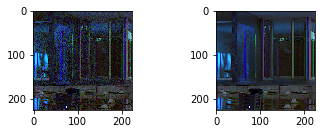

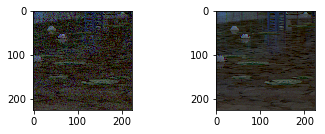

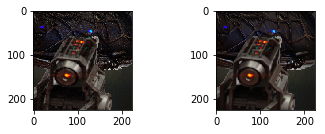

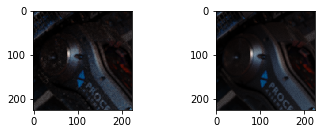

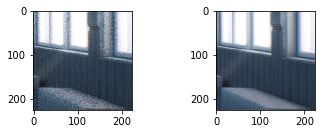

In [4]:
  for i in range(5):
    plt.figure(i)
    plt.grid(b=False)
    plt.subplot(221)           
    plt.imshow(lowsampleimgs[i,:,:,:])
    plt.subplot(222)             
    plt.imshow(highsampleimgs[i,:,:,:])
    plt.show()


Now we start to train our network.

In [ ]:
checkpointer = ModelCheckpoint(filepath="./Models/model_x.hdf5", verbose=0)
m_model.fit(lowsampleimgs, highsampleimgs,
                epochs=100,
                batch_size=30,
                shuffle=True,
                 callbacks=[checkpointer])

Then we unfreeze the VGG layer and train for another 10 epochs.

In [ ]:
#unfreeze and train
for layer in m_model.layers:
    layer.trainable = True
m_model.fit(lowsampleimgs, highsampleimgs,
                epochs=10,
                batch_size=30,
                shuffle=True,
                 callbacks=[checkpointer])

We got a final loss of 0.4082

## Result evaluation

First we evaluate our results using small patches.

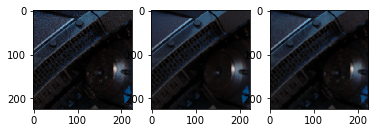

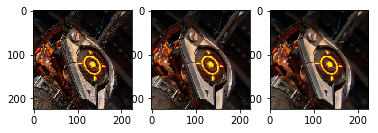

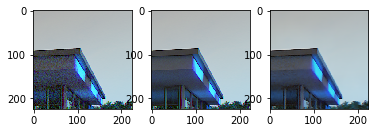

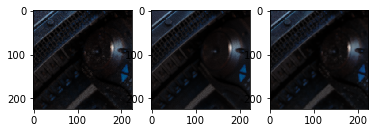

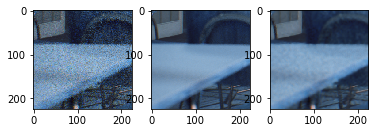

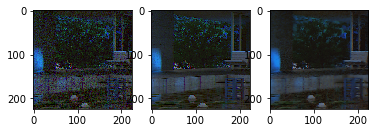

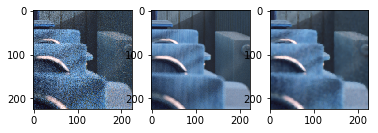

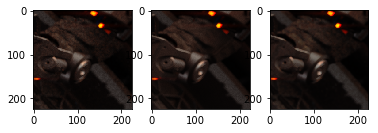

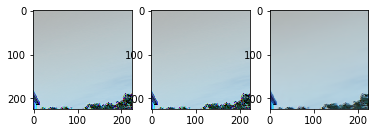

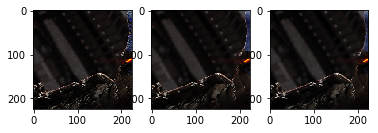

In [5]:
from keras.models import load_model

m_model = load_model('dl/GAN/Models/model_x.hdf5')
result = m_model.predict(testimgs[:10])

for i in range(10):
    plt.figure(i)              
    plt.subplot(131)           
    plt.imshow(lowsampleimgs[i])
    plt.subplot(132)           
    plt.imshow(highsampleimgs[i])
    plt.subplot(133)
    plt.imshow(result[i])
    plt.show()

From left to right are the low sample input image, high sample ground truth and our output prediction.

We can see that our output has much less noise compare to the input, also it is very similar to the ground truth.

Then we show some result for a whole image. We split a high resolution image with low sample into several small patch whose size is (224,224,3), after send into the network, we combine them together to get the final output.

Low sample input


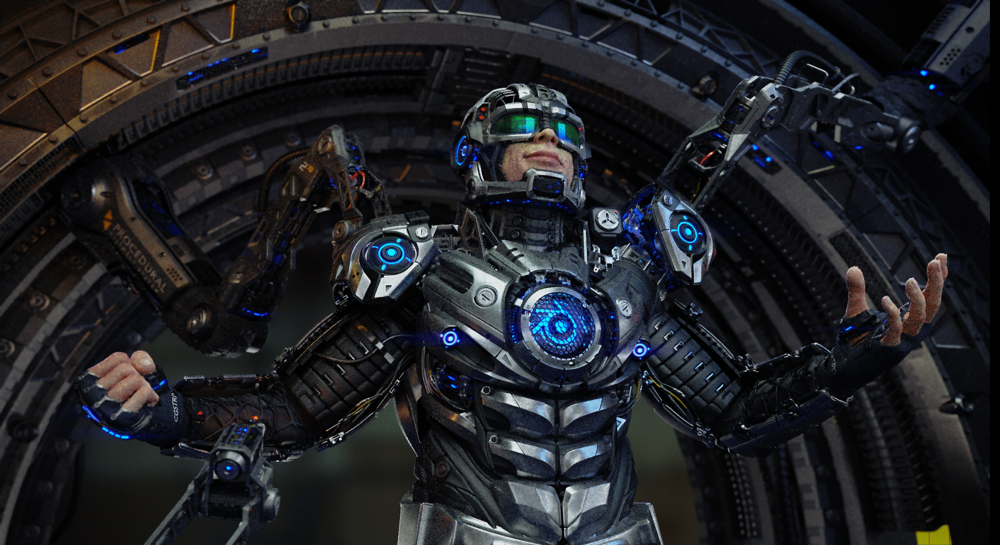

In [2]:
print("Low sample input")
Image(filename='./data/low/blenderman.png')

Ground truth


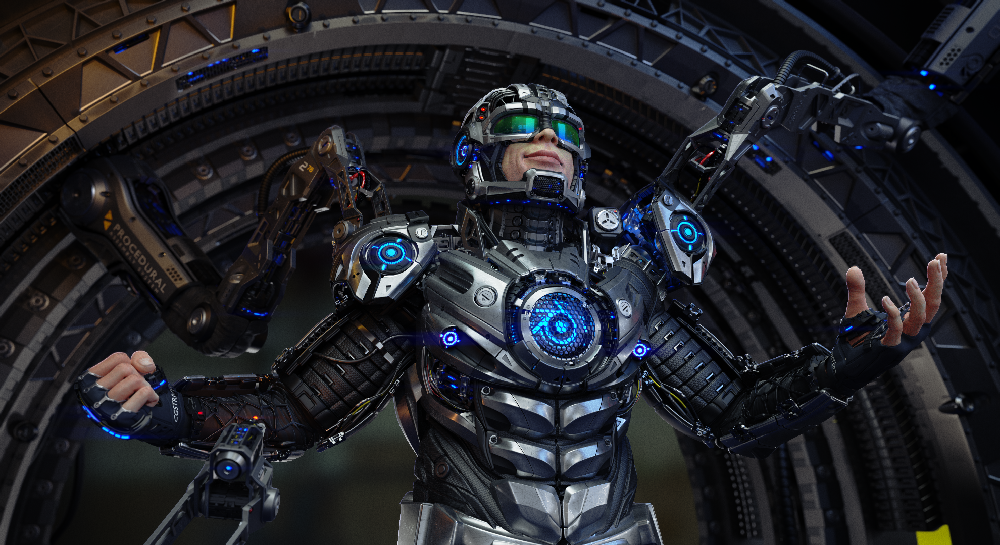

In [5]:
print("Ground truth")
Image(filename='./data/high/blenderman.png')

Our prediction


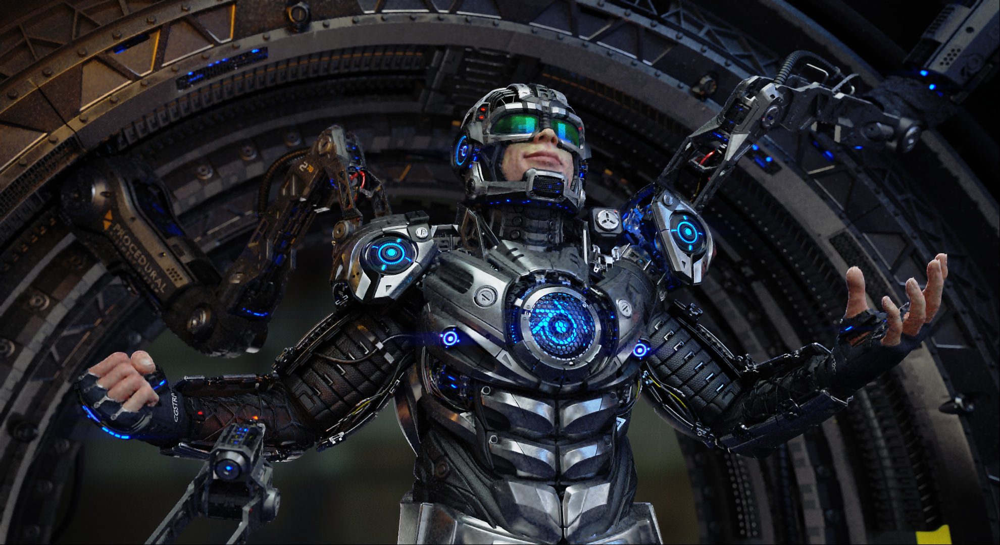

In [7]:
print("Our prediction")
Image(filename='./Result/blenderman_res.png')

Low sample input


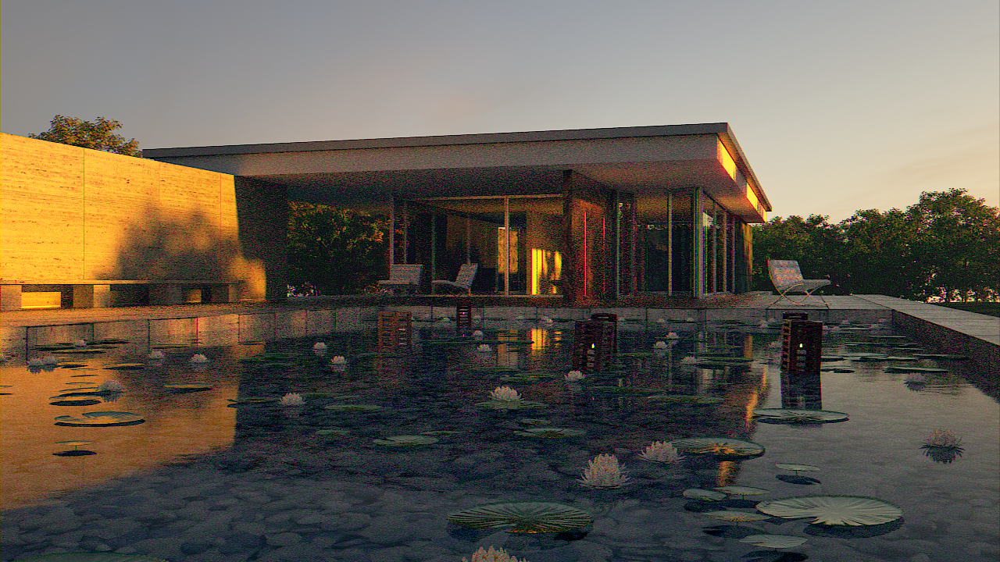

In [8]:
print("Low sample input")
Image(filename='./data/low/pa.png')

Ground truth


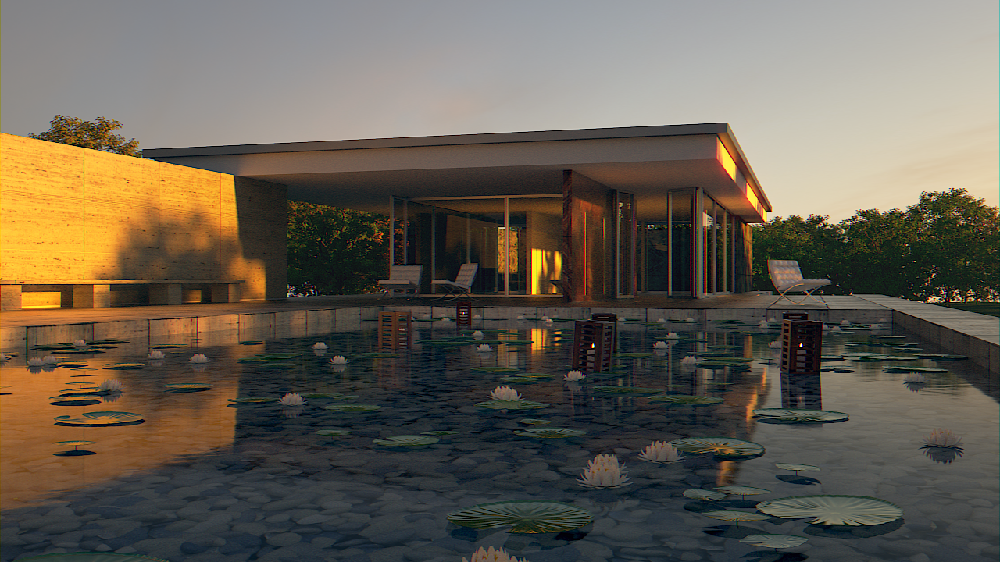

In [9]:
print("Ground truth")
Image(filename='./data/high/pa.png')

Our prediction


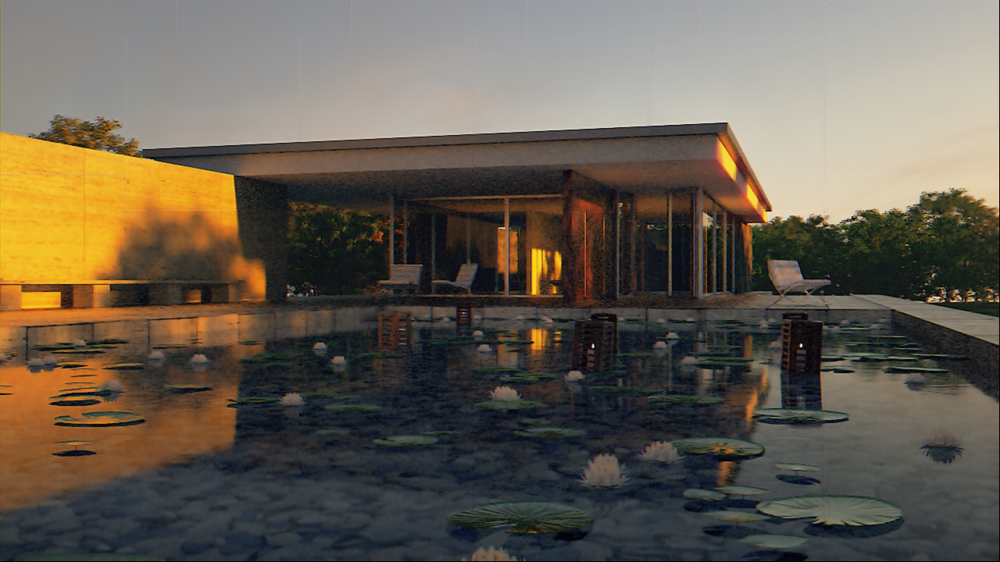

In [10]:
print("Our prediction")
Image(filename='./Result/pa_res.png')

## Extension: One-shot learning for video rendering

To further extend our framework, we introduce an one-shot learning[4] scheme for video rendering.

Since different frames in a continuous video sequence share very similar scene structure and lighting conditions, learning a transform function for one single frame may able to transfer to its neighbor frames.

In this application, we rendered a video sequence with very low sample, it cost 5 secs to render a single frame with totally 150 frames. We pick a frame randomly and render it with high sample which serves as our only training data.

Below is our result video on youtube.

This is the input low sample video. It cost 5 secs for one frame and 12.5 min for total 150 frames. (Youtube may damaged the video quality due to compression)

[Low Sample Video](https://www.youtube.com/watch?v=5P6CkI7nRnY)

This is our output result. It cost only 1 hr to evaluate all frames. It looks much smoother than the input.

[Output of our network](https://www.youtube.com/watch?v=Eh9q-GYHBh8)

To compare our result, we also use a higher sampled vidoe sequence, which cost 7 hrs to render. It still looks worse than our result.

[High Sample Video](https://www.youtube.com/watch?v=gAVH9oMr_3Y)

## References

[1] Kajiya, James T. (1986), "The rendering equation", Siggraph 1986: 143, doi:10.1145/15922.15902, ISBN 0-89791-196-2

[2] Kaiming	He,	Xiangyu	Zhang,	Shaoqing Ren & Jian	Sun. “Deep Residual	Learning for Image Recognition”. CVPR 2016.

[3] Blender Foundation, Blender - a 3D modelling and rendering package

[4] L. Fei-Fei, "Knowledge transfer in learning to recognize visual object classes." International Conference on Development and Learning (ICDL). 2006

[5] K. Simonyan, A. Zisserman, "Very Deep Convolutional Networks for Large-Scale Image Recognition". 2014.

[6] Burger, Harold Christopher, Christian J. Schuler, and Stefan Harmeling. "Image denoising with multi-layer perceptrons, part 1: comparison with existing algorithms and with bounds." arXiv preprint arXiv:1211.1544 (2012).
